# controlnet
## canny

1. 加载模型

In [3]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL
from diffusers.utils import make_image_grid
import torch

controlnet = ControlNetModel.from_pretrained(
    "/home/zjt/model/controlnet-canny-sdxl-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True
)
vae = AutoencoderKL.from_pretrained("/home/zjt/model/sdxl-vae-fp16-fix", torch_dtype=torch.float16, use_safetensors=True)
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    "/home/zjt/model/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    vae=vae,
    torch_dtype=torch.float16,
    use_safetensors=True
)
pipe.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

2. 拿一个字体写几个字

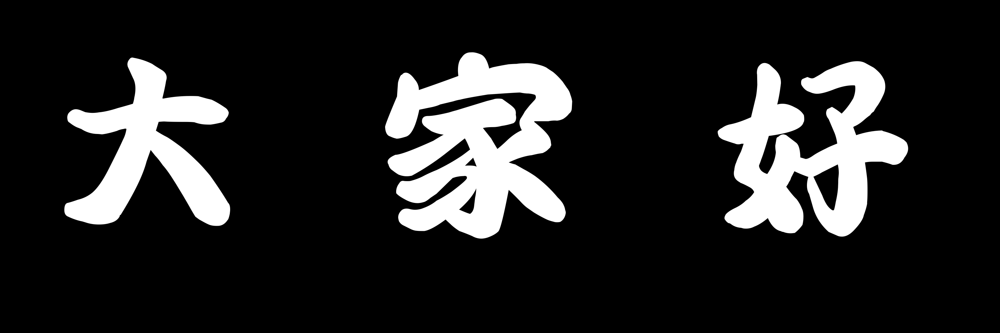

In [31]:
from PIL import Image,ImageDraw,ImageFont,ImageFilter

font_path = '/home/zjt/workspace/ocr/fakedata/fakedata_rec/fonts/000014.ttf'
font = ImageFont.truetype(font_path, 600, encoding="utf-8")
img_l = []
for w in '大家好':
    img = Image.new('RGB',(1024,1024),(0,0,0))
    draw = ImageDraw.Draw(img)
    draw.text([150, 150], w, font=font)
    img_l.append(img)
make_image_grid(img_l, rows=1, cols=3)

3. 取个轮廓

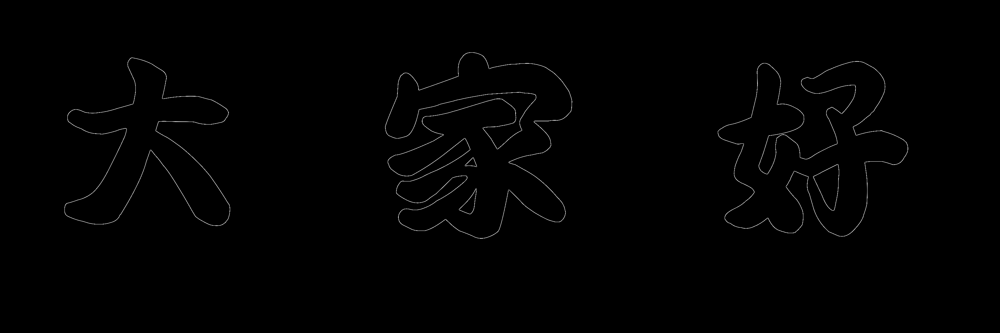

In [32]:
img_l2 = [img1.filter(ImageFilter.FIND_EDGES) for img1 in img_l]
make_image_grid(img_l2, rows=1, cols=3)

4. 画个项链试试

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

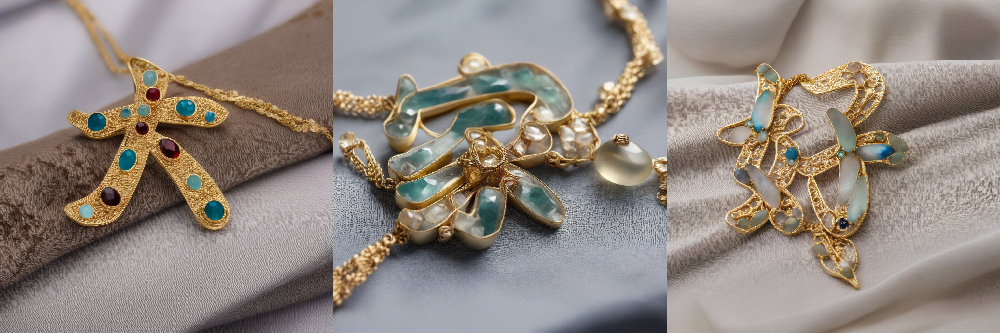

In [33]:
prompt = "A necklace with gold and gemstones on it"
negative_prompt = 'low quality, bad quality, sketches'
img_l3 = []
for canny_image in img_l2:
    image = pipe(
        prompt,
        negative_prompt=negative_prompt,
        image=canny_image,
        controlnet_conditioning_scale=0.7,
    ).images[0]
    img_l3.append(image)
make_image_grid(img_l3, rows=1, cols=3)

5. guess_mode 试试

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

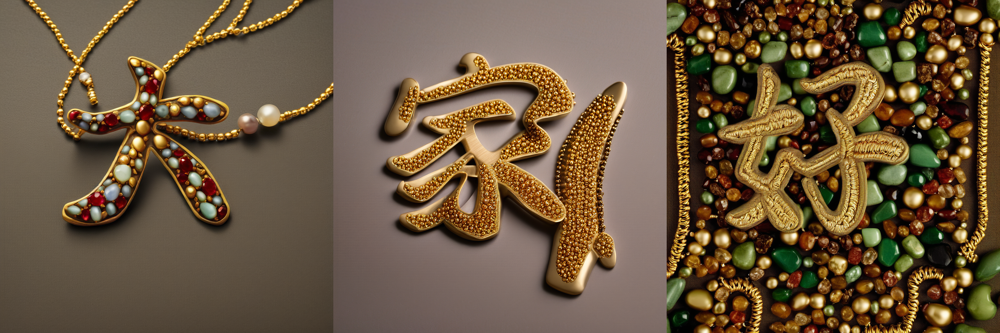

In [37]:
prompt = "A necklace with gold and gemstones on it"
negative_prompt = 'low quality, bad quality, sketches'
img_l3 = []
for canny_image in img_l2:
    image = pipe(
        prompt,
        negative_prompt=negative_prompt,
        image=canny_image,
        controlnet_conditioning_scale=0.7,
        guess_mode=True
    ).images[0]
    img_l3.append(image)
make_image_grid(img_l3, rows=1, cols=3)

换个提示词,画个女孩

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

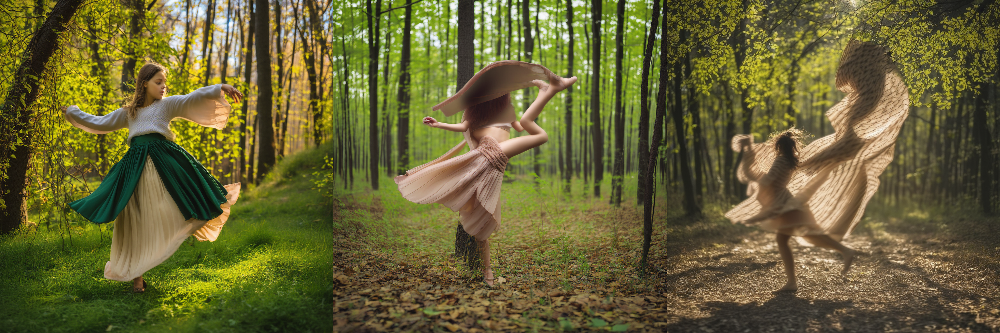

In [39]:
prompt = "A girl in a skirt is dancing in the forest"
negative_prompt = 'low quality, bad quality, sketches'
img_l3 = []
for canny_image in img_l2:
    image = pipe(
        prompt,
        negative_prompt=negative_prompt,
        image=canny_image,
        controlnet_conditioning_scale=0.5,
        guess_mode=True
    ).images[0]
    img_l3.append(image)
make_image_grid(img_l3, rows=1, cols=3)

第二个图这个腿分岔了